In [39]:
import pandas as pd
import numpy as np

import matplotlib.pyplot as plt
import seaborn as sns

from sklearn.model_selection import train_test_split

import warnings
warnings.filterwarnings('ignore')

In [2]:
weather = pd.read_csv('train_data.csv', index_col='index')

In [4]:
pd.options.display.max_rows = 1000

In [4]:
weather['startdate'] = pd.to_datetime(weather['startdate'])

In [ ]:
#weather = weather.set_index('startdate').sort_index()

In [5]:
weather.head()

,lat,lon,startdate,contest-pevpr-sfc-gauss-14d__pevpr,nmme0-tmp2m-34w__cancm30,nmme0-tmp2m-34w__cancm40,nmme0-tmp2m-34w__ccsm30,nmme0-tmp2m-34w__ccsm40,nmme0-tmp2m-34w__cfsv20,nmme0-tmp2m-34w__gfdlflora0,...,wind-vwnd-925-2010-11,wind-vwnd-925-2010-12,wind-vwnd-925-2010-13,wind-vwnd-925-2010-14,wind-vwnd-925-2010-15,wind-vwnd-925-2010-16,wind-vwnd-925-2010-17,wind-vwnd-925-2010-18,wind-vwnd-925-2010-19,wind-vwnd-925-2010-20
index,,,,,,,,,,,,,,,,,,,,,
0,0.0,0.833333,2014-09-01,237.00,29.02,31.64,29.57,30.73,29.71,31.52,...,-27.68,-37.21,8.32,9.56,-2.03,48.13,28.09,-13.50,11.90,4.58
1,0.0,0.833333,2014-09-02,228.90,29.02,31.64,29.57,30.73,29.71,31.52,...,-21.13,-36.57,8.77,21.17,4.44,48.60,27.41,-23.77,15.44,3.42
2,0.0,0.833333,2014-09-03,220.69,29.02,31.64,29.57,30.73,29.71,31.52,...,-10.72,-34.16,6.99,32.16,5.01,48.53,19.21,-33.16,15.11,4.82
3,0.0,0.833333,2014-09-04,225.28,29.02,31.64,29.57,30.73,29.71,31.52,...,0.33,-31.04,6.17,39.66,-1.41,50.59,8.29,-37.22,18.24,9.74
4,0.0,0.833333,2014-09-05,237.24,29.02,31.64,29.57,30.73,29.71,31.52,...,9.83,-31.80,7.47,38.62,-5.21,54.73,-2.58,-42.30,21.91,10.95


In [22]:
weather.shape

(375734, 245)

In [6]:
weather.columns

Index(['index', 'lat', 'lon', 'startdate',
       'contest-pevpr-sfc-gauss-14d__pevpr', 'nmme0-tmp2m-34w__cancm30',
       'nmme0-tmp2m-34w__cancm40', 'nmme0-tmp2m-34w__ccsm30',
       'nmme0-tmp2m-34w__ccsm40', 'nmme0-tmp2m-34w__cfsv20',
       ...
       'wind-vwnd-925-2010-11', 'wind-vwnd-925-2010-12',
       'wind-vwnd-925-2010-13', 'wind-vwnd-925-2010-14',
       'wind-vwnd-925-2010-15', 'wind-vwnd-925-2010-16',
       'wind-vwnd-925-2010-17', 'wind-vwnd-925-2010-18',
       'wind-vwnd-925-2010-19', 'wind-vwnd-925-2010-20'],
      dtype='object', length=246)

In [23]:
## check the data missing values
weather[weather.columns[weather.isnull().any()]].isnull().sum()

nmme0-tmp2m-34w__ccsm30    15934
nmme-tmp2m-56w__ccsm3      10280
nmme-prate-34w__ccsm3       8738
nmme0-prate-56w__ccsm30    15934
nmme0-prate-34w__ccsm30    15934
nmme-prate-56w__ccsm3      10280
nmme-tmp2m-34w__ccsm3       8738
ccsm30                     15934
dtype: int64

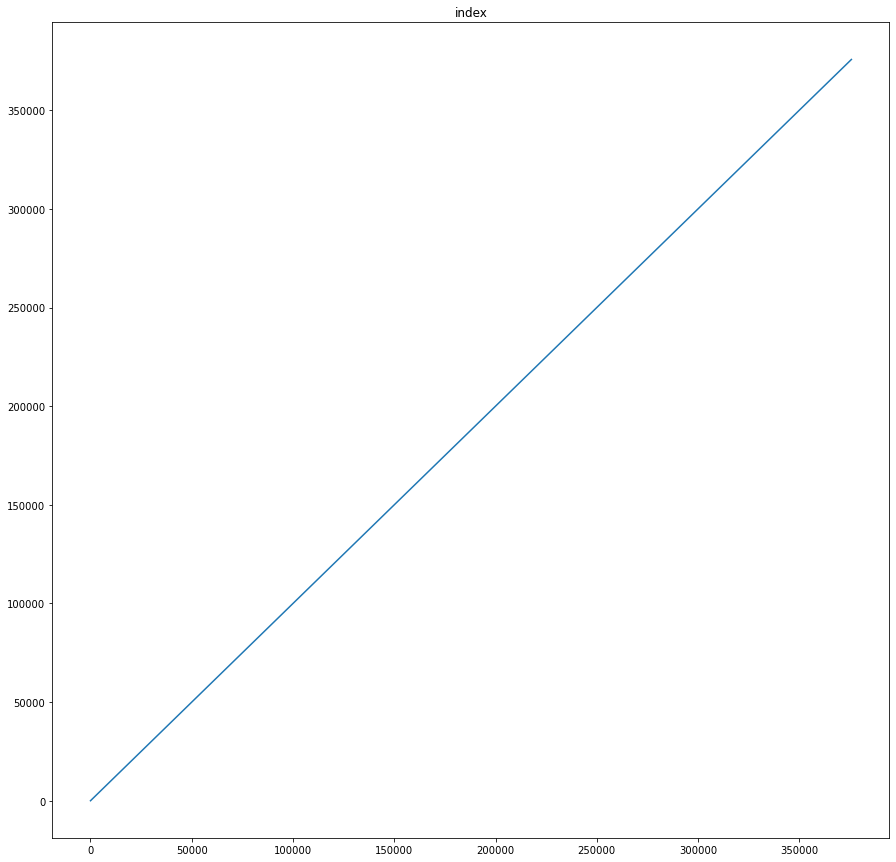

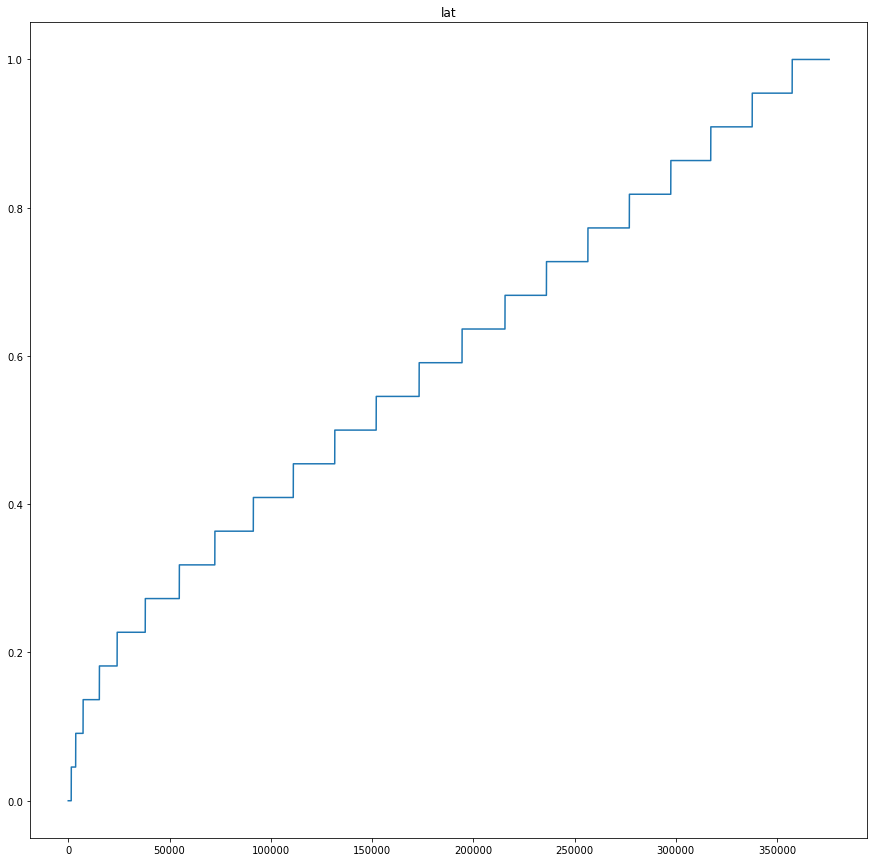

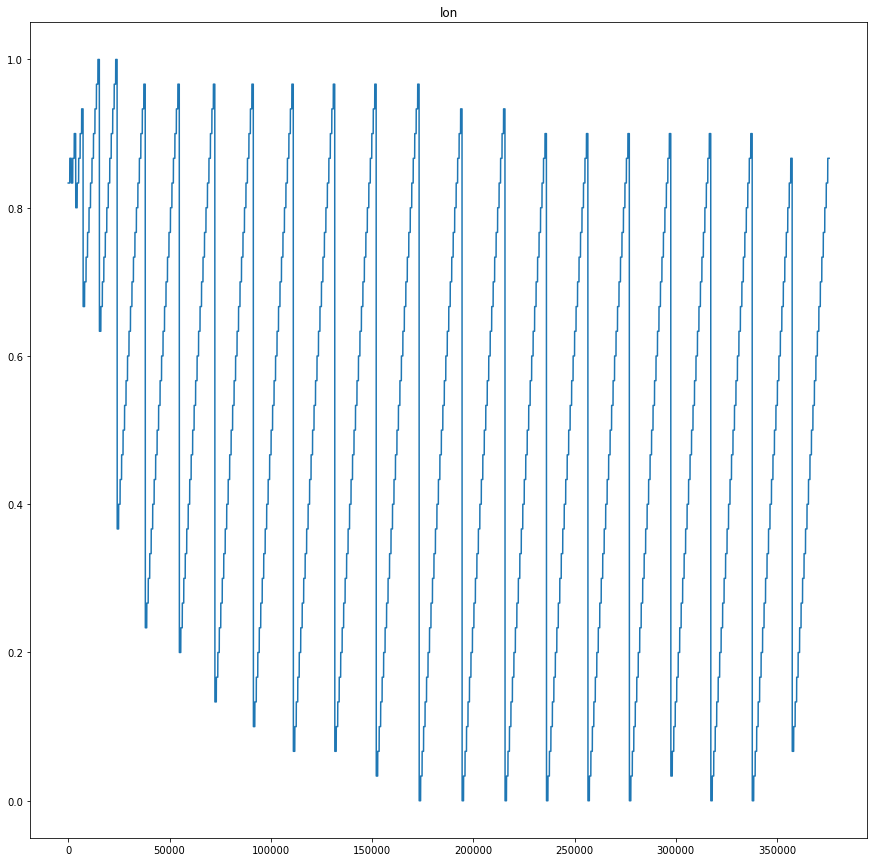

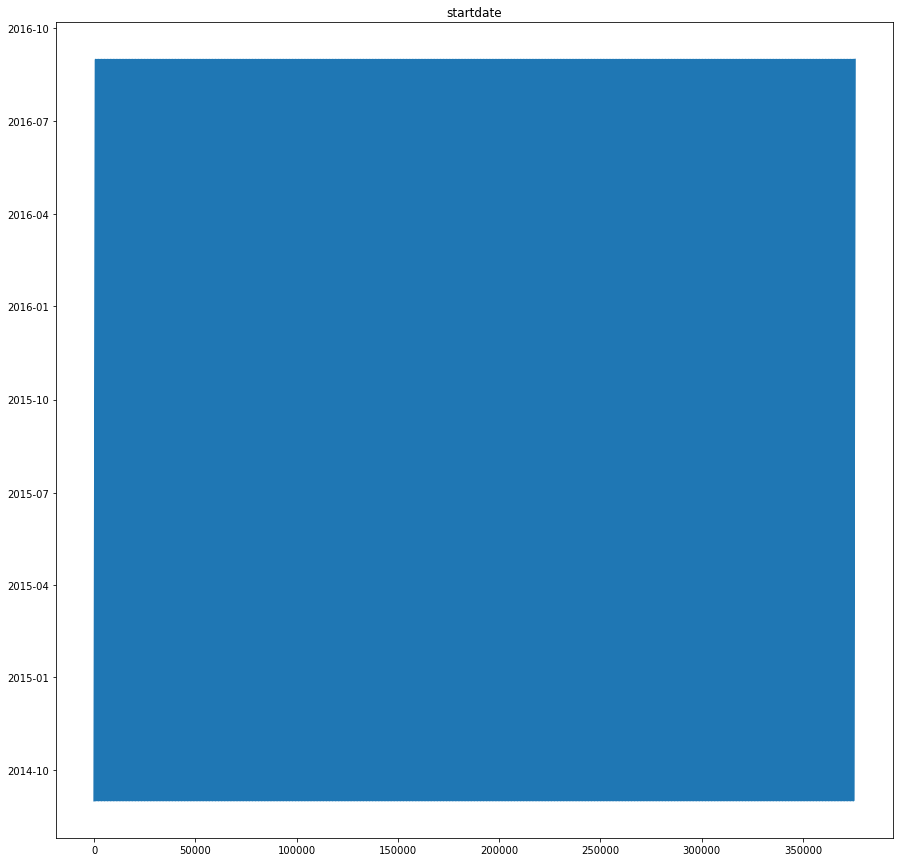

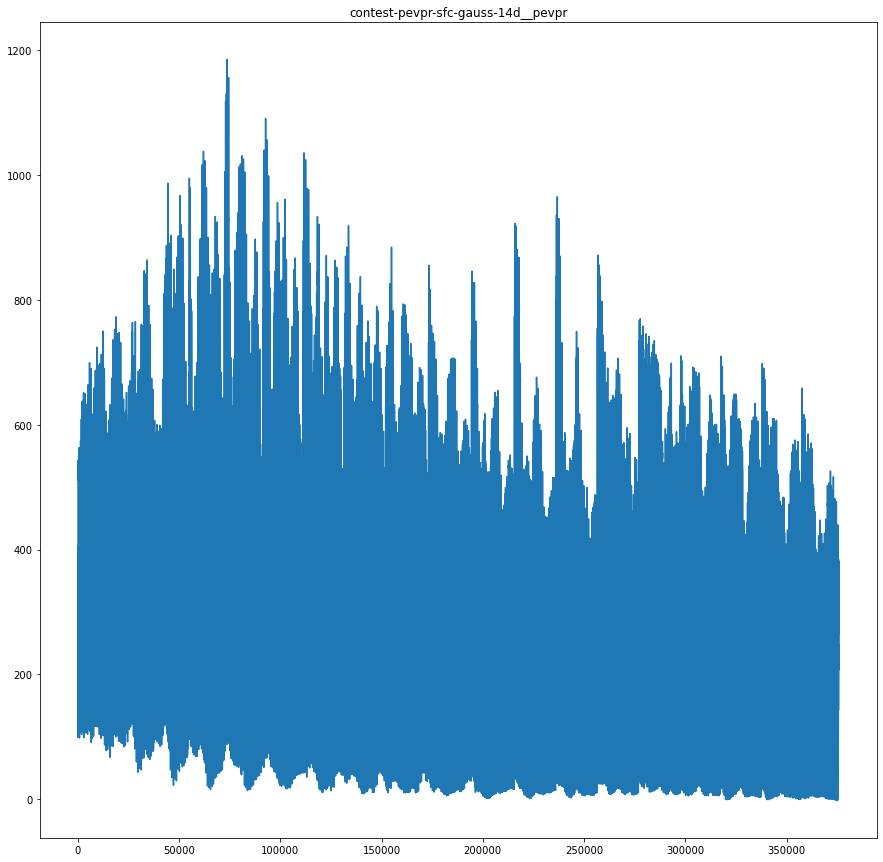

...

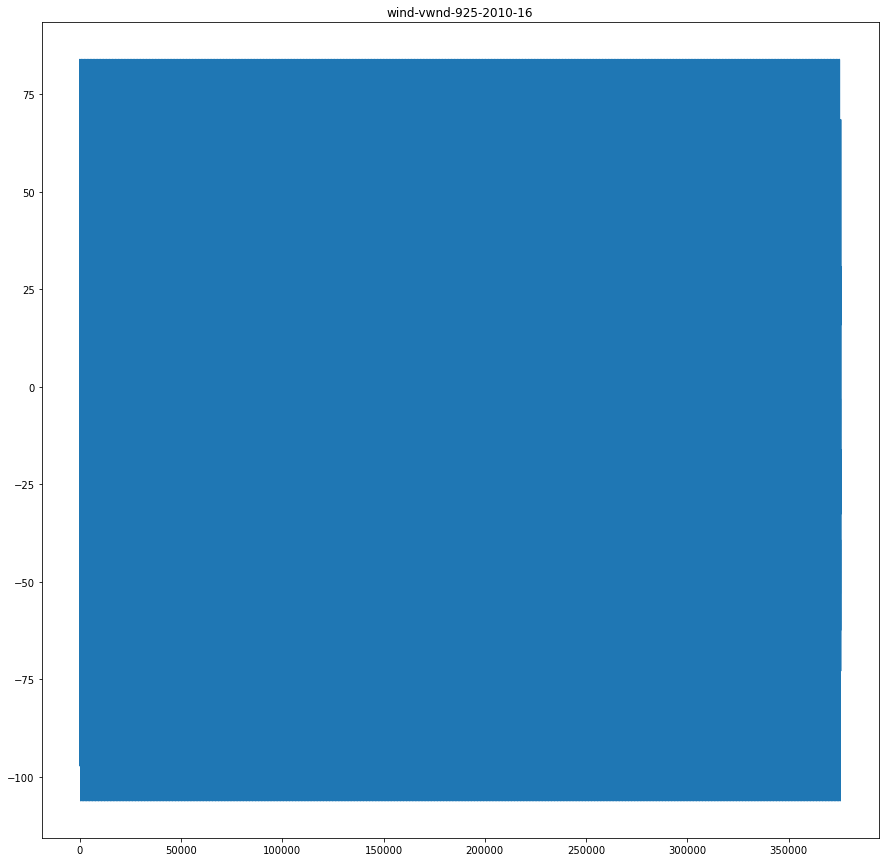

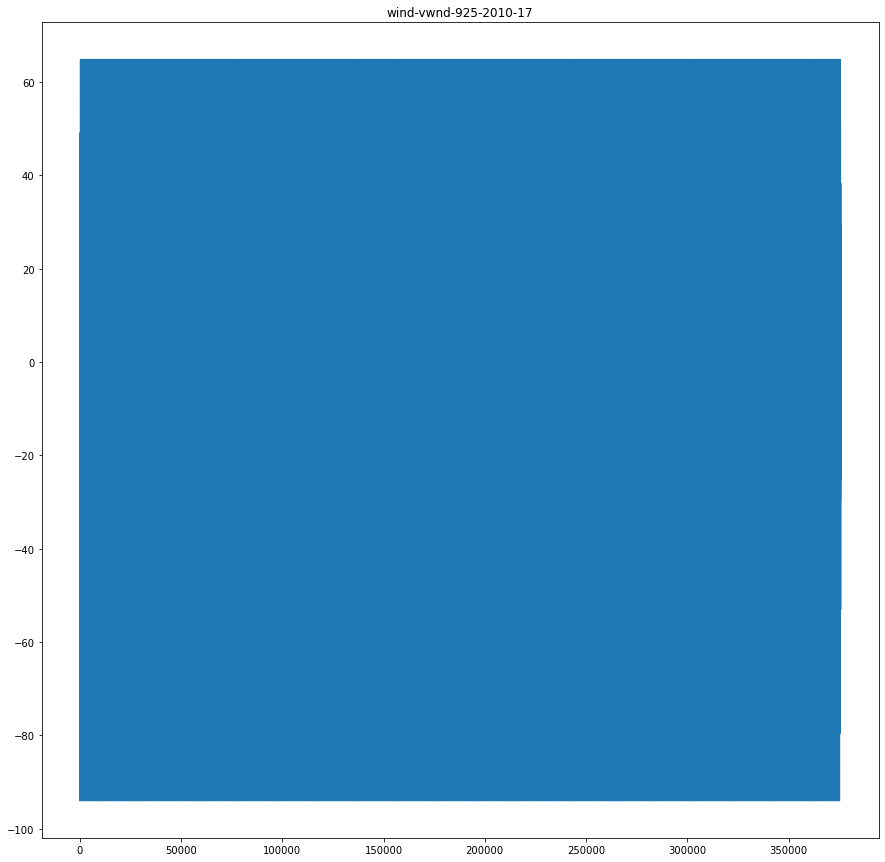

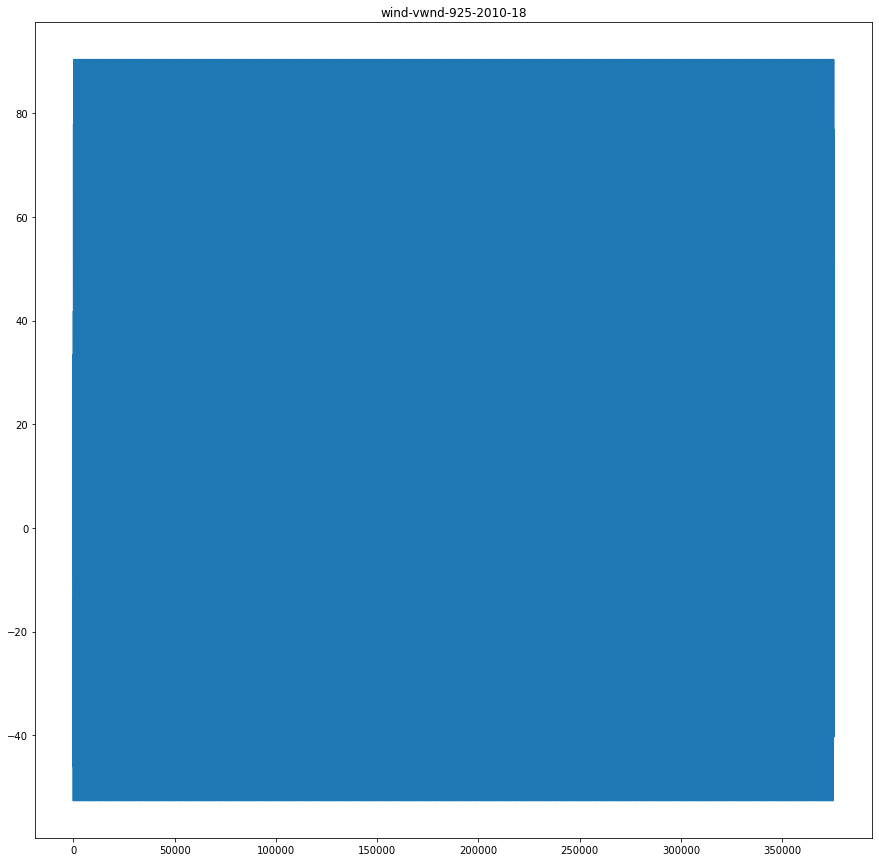

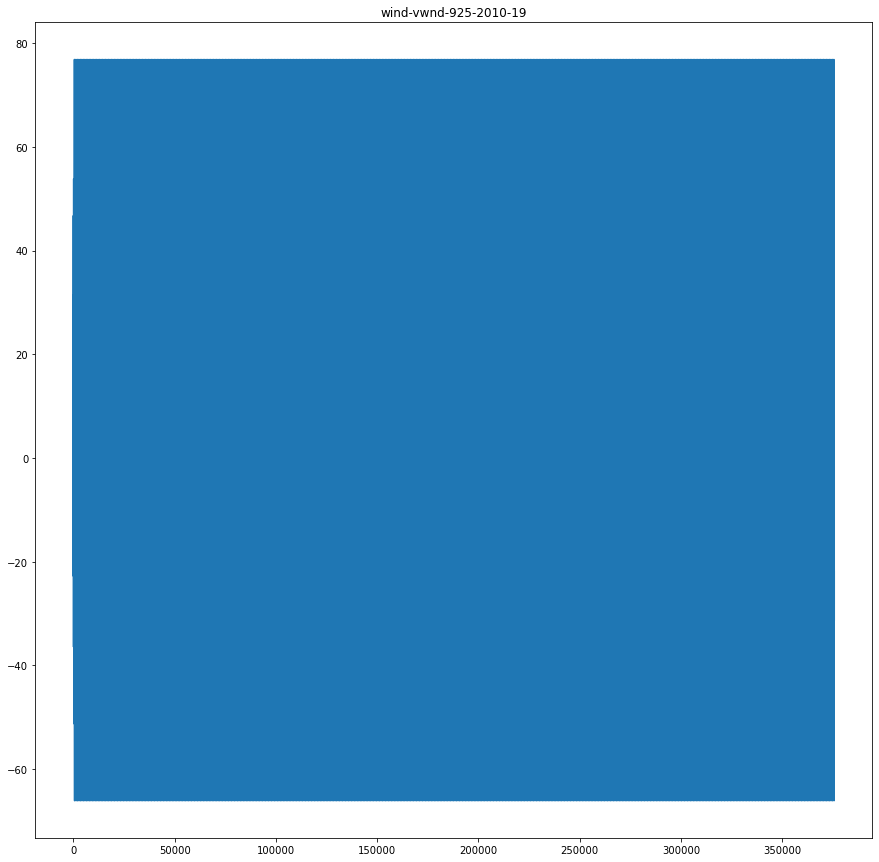

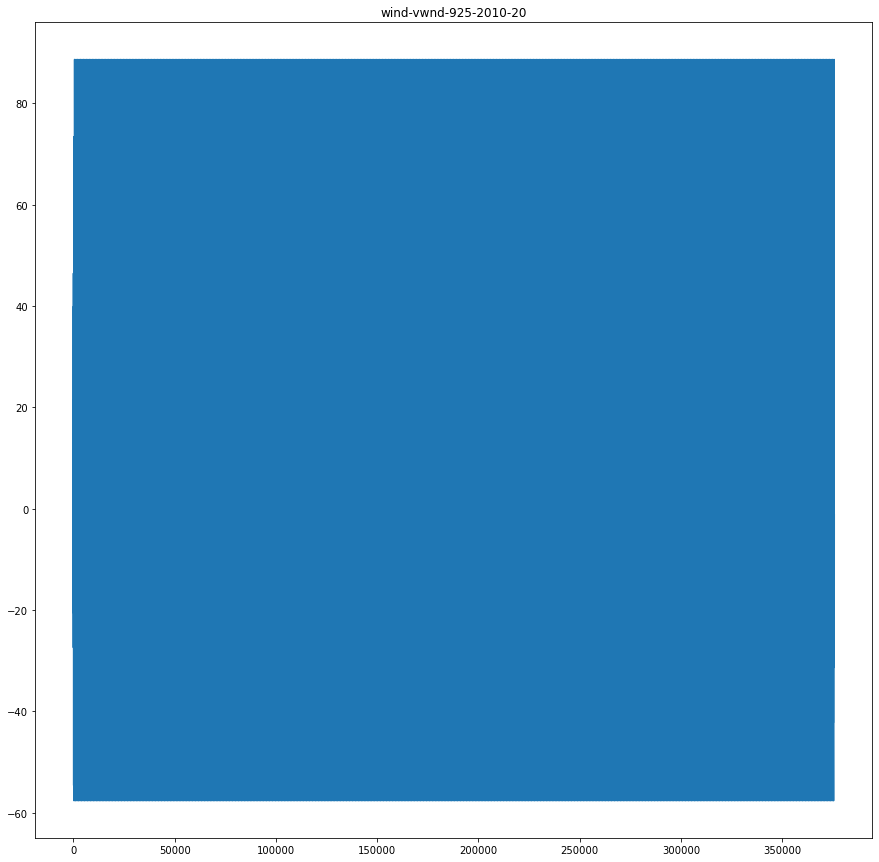

In [7]:
for col in weather.columns:
    fig, ax = plt.subplots(figsize=(15, 15))
    plt.plot(weather[col])
    plt.title(f'{col}')
    plt.show()

In [ ]:
weather.elevation__elevation.describe()

In [ ]:
weather.columns

In [6]:
location1 = weather.head(731)

In [7]:
location1 = location1.set_index('startdate').sort_index()

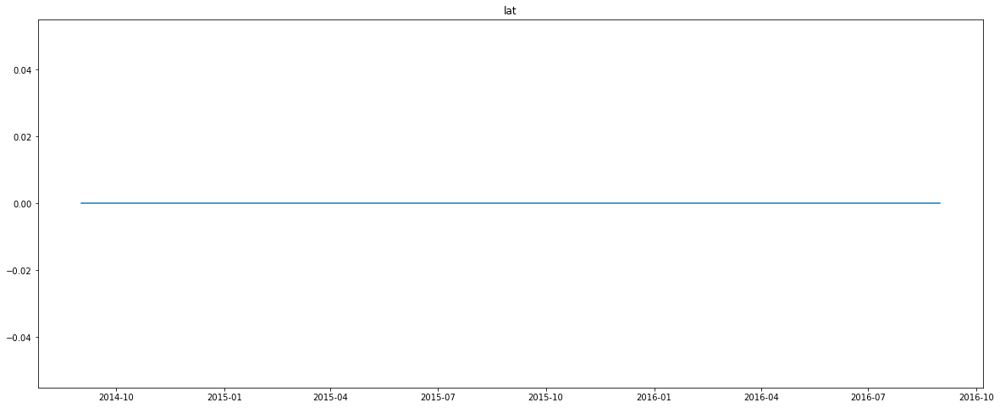

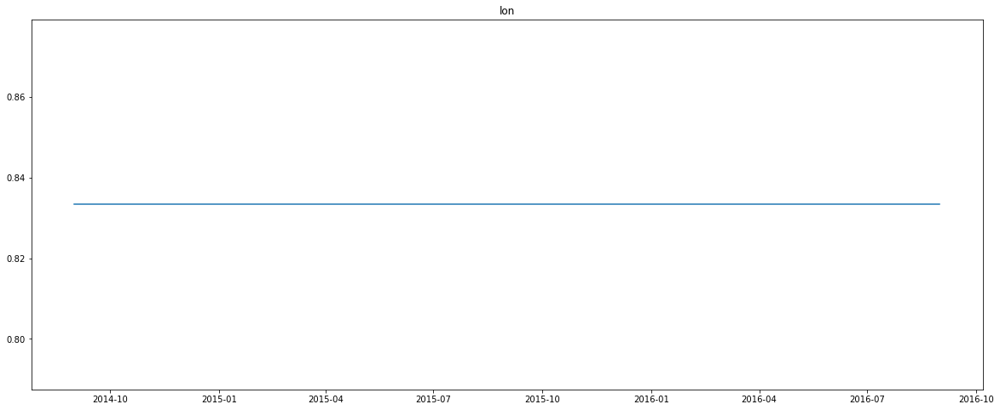

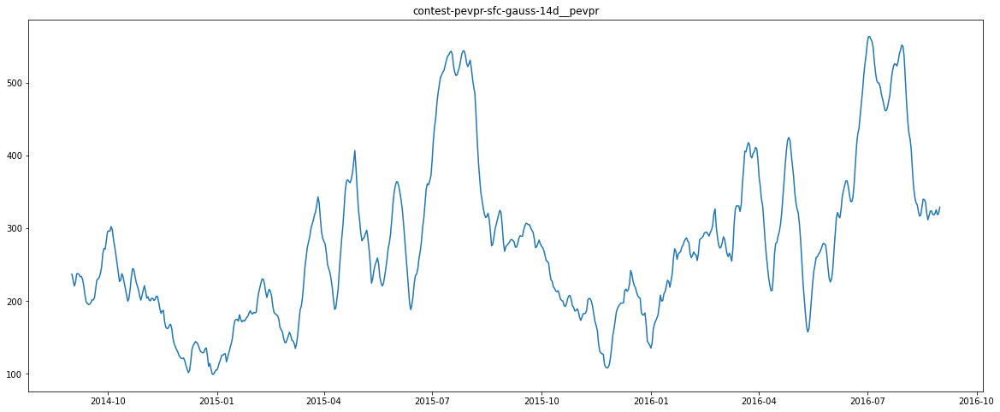

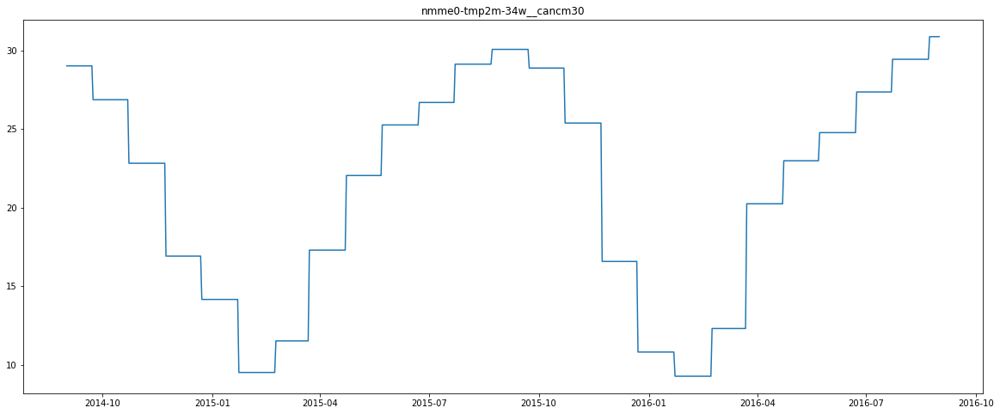

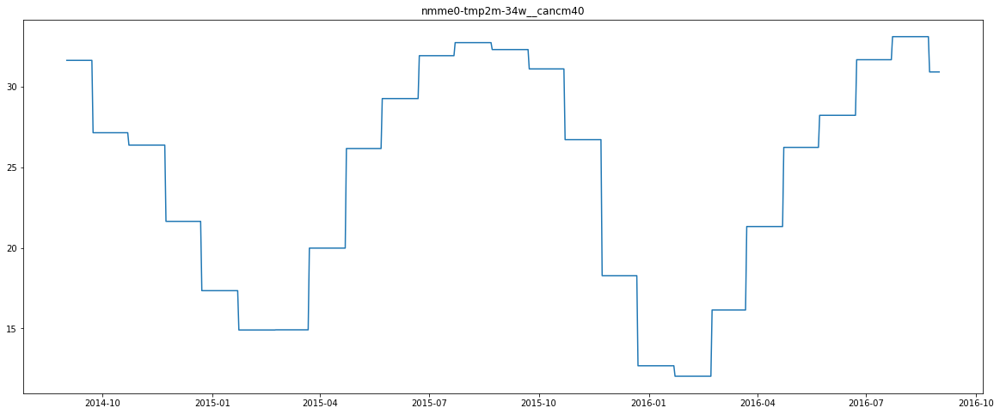

...

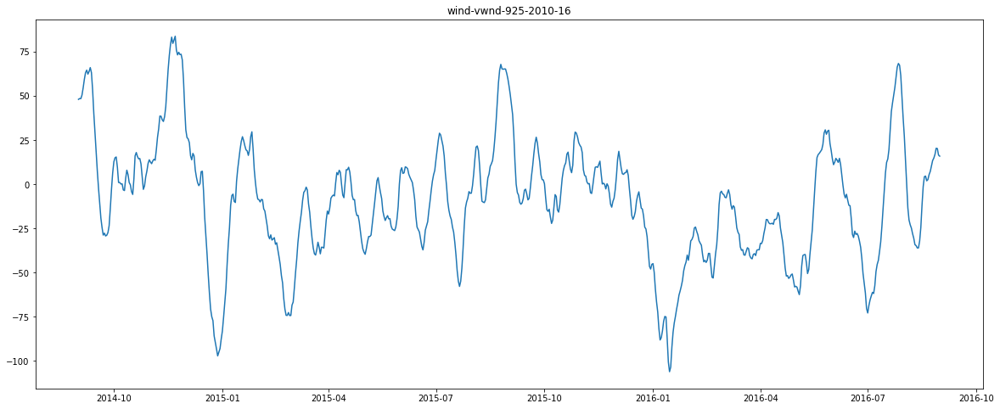

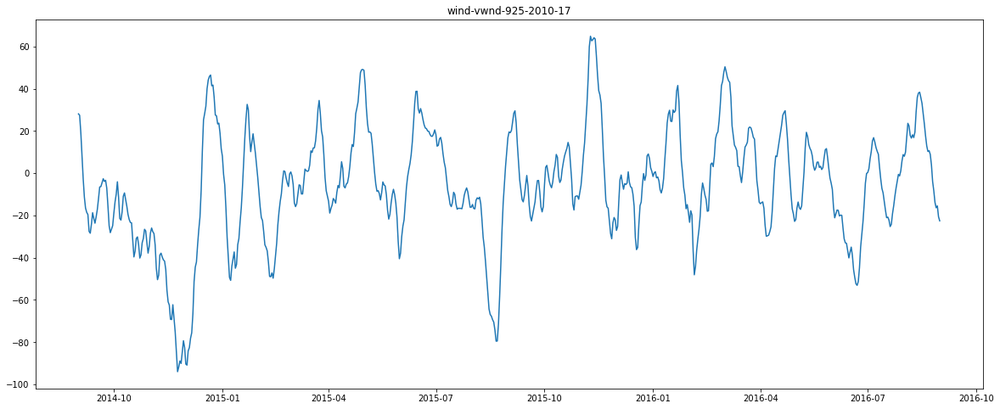

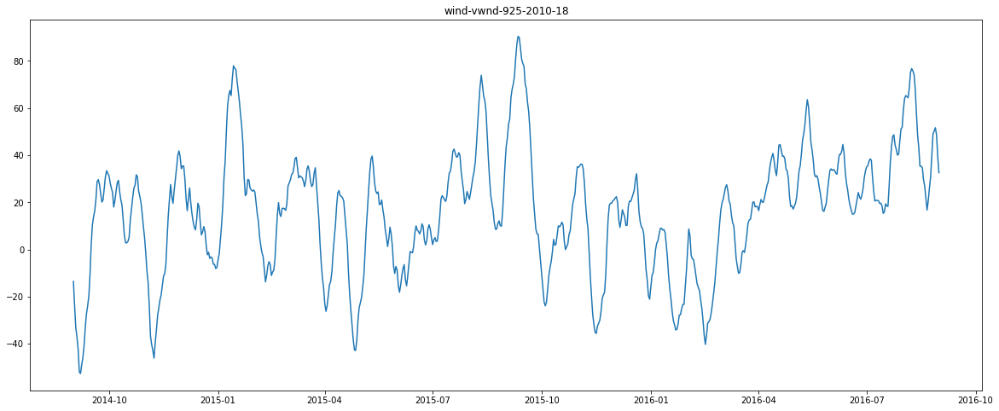

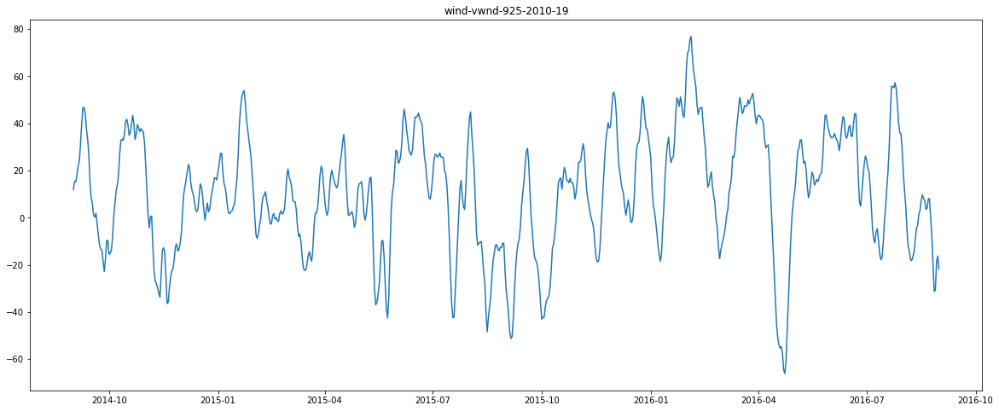

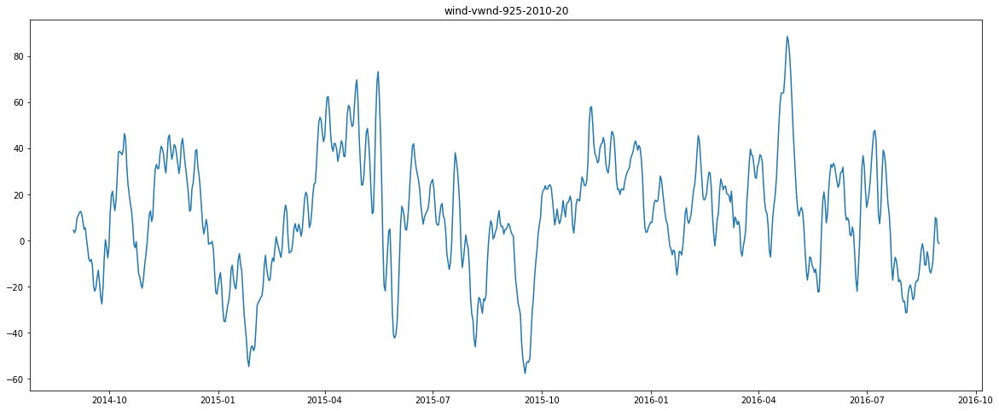

In [10]:
for col in location1.columns:
    fig, ax = plt.subplots(figsize=(20, 8))
    plt.plot(location1[col])
    plt.title(f'{col}')
    plt.show()

In [20]:
import statsmodels.api as sm

In [25]:
y = location1['contest-tmp2m-14d__tmp2m'].resample('d').mean()

result = sm.tsa.seasonal_decompose(y)
decomposition = pd.DataFrame({
    'y': result.observed,
    'trend': result.trend,
    'seasonal': result.seasonal,
    'resid': result.resid,
})
decomposition.head()

,y,trend,seasonal,resid
startdate,,,,
2014-09-01,28.744480,NaN,0.002885,NaN
2014-09-02,28.370585,NaN,0.003043,NaN
2014-09-03,28.133059,NaN,0.001777,NaN
2014-09-04,28.256798,28.407382,-0.001632,-0.148952
2014-09-05,28.372353,28.345746,-0.002975,0.029582


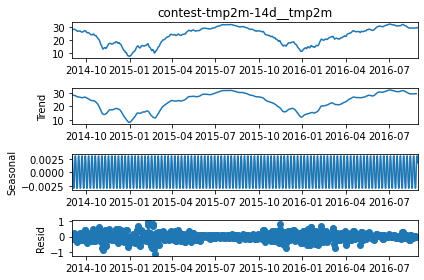

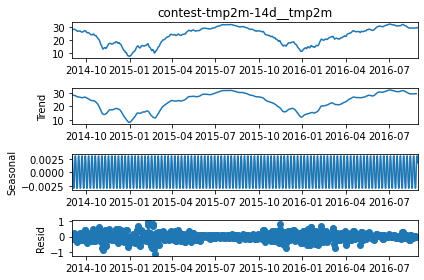

In [26]:
result.plot()

In [5]:
weather_describe = weather.describe().T

In [15]:
contest = list(weather_describe[weather_describe.index.str.contains('contest')].index)




In [16]:
contest.append('elevation__elevation')
contest.append('lat')
contest.append('lon')
contest.append('startdate')

In [17]:
contest_df = weather[contest]

In [18]:
contest_df.info()

<class 'pandas.core.frame.DataFrame'>
Int64Index: 375734 entries, 0 to 375733
Data columns (total 19 columns):
 #   Column                                    Non-Null Count   Dtype         
---  ------                                    --------------   -----         
 0   contest-pevpr-sfc-gauss-14d__pevpr        375734 non-null  float64       
 1   contest-wind-h10-14d__wind-hgt-10         375734 non-null  float64       
 2   contest-rhum-sig995-14d__rhum             375734 non-null  float64       
 3   contest-wind-h100-14d__wind-hgt-100       375734 non-null  float64       
 4   contest-tmp2m-14d__tmp2m                  375734 non-null  float64       
 5   contest-slp-14d__slp                      375734 non-null  float64       
 6   contest-wind-vwnd-925-14d__wind-vwnd-925  375734 non-null  float64       
 7   contest-pres-sfc-gauss-14d__pres          375734 non-null  float64       
 8   contest-wind-uwnd-250-14d__wind-uwnd-250  375734 non-null  float64       
 9   contest-prwtr-e

In [19]:
contest_df.head()

,contest-pevpr-sfc-gauss-14d__pevpr,contest-wind-h10-14d__wind-hgt-10,contest-rhum-sig995-14d__rhum,contest-wind-h100-14d__wind-hgt-100,contest-tmp2m-14d__tmp2m,contest-slp-14d__slp,contest-wind-vwnd-925-14d__wind-vwnd-925,contest-pres-sfc-gauss-14d__pres,contest-wind-uwnd-250-14d__wind-uwnd-250,contest-prwtr-eatm-14d__prwtr,contest-wind-vwnd-250-14d__wind-vwnd-250,contest-precip-14d__precip,contest-wind-h850-14d__wind-hgt-850,contest-wind-uwnd-925-14d__wind-uwnd-925,contest-wind-h500-14d__wind-hgt-500,elevation__elevation,lat,lon,startdate
index,,,,,,,,,,,,,,,,,,,
0,237.00,31246.63,81.72,16666.81,28.744480,101352.08,4.41,98644.97,-2.56,42.45,-3.52,94.31,1535.52,-5.22,5899.66,200.0,0.0,0.833333,2014-09-01
1,228.90,31244.78,82.56,16667.31,28.370585,101396.02,3.74,98686.80,-2.39,42.66,-4.49,100.85,1538.00,-5.20,5901.03,200.0,0.0,0.833333,2014-09-02
2,220.69,31239.27,83.29,16668.39,28.133059,101429.25,3.40,98712.85,-2.76,43.23,-5.44,101.25,1540.32,-5.00,5902.18,200.0,0.0,0.833333,2014-09-03
3,225.28,31232.86,83.26,16667.39,28.256798,101440.85,3.29,98711.70,-3.00,43.11,-5.76,101.90,1541.10,-4.61,5903.07,200.0,0.0,0.833333,2014-09-04
4,237.24,31226.16,82.50,16665.65,28.372353,101419.53,3.27,98686.46,-3.40,42.98,-6.09,82.95,1539.73,-4.25,5903.36,200.0,0.0,0.833333,2014-09-05


In [20]:
contest_df = contest_df.set_index('startdate').sort_index()

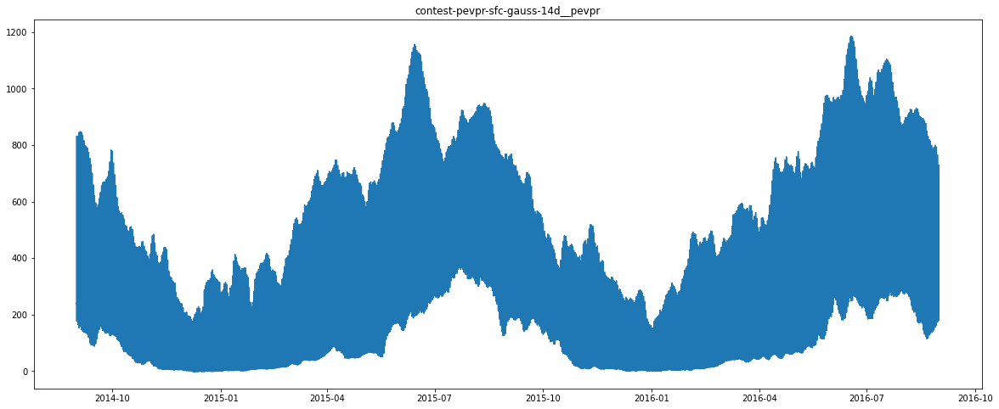

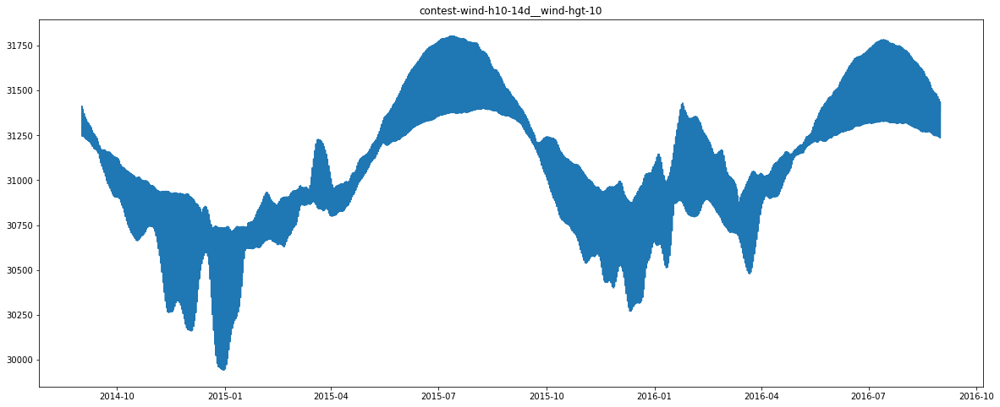

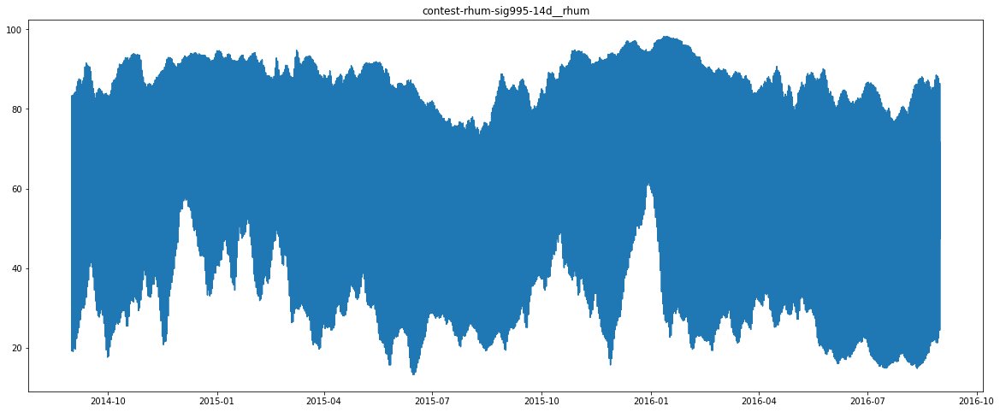

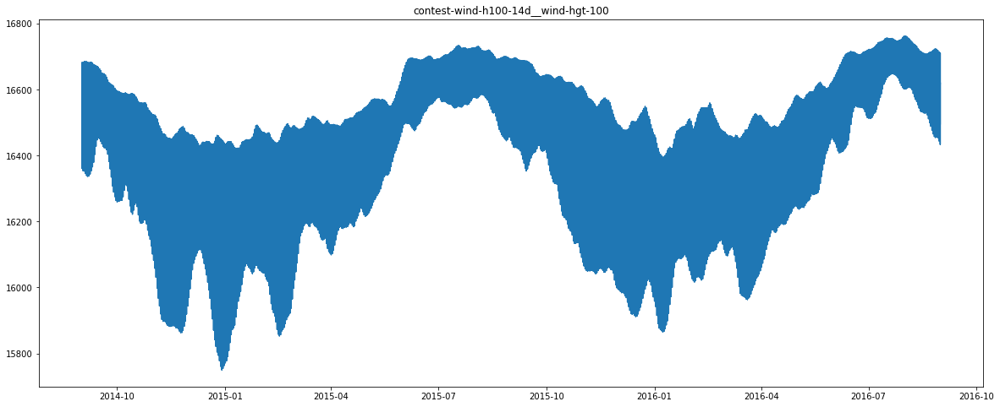

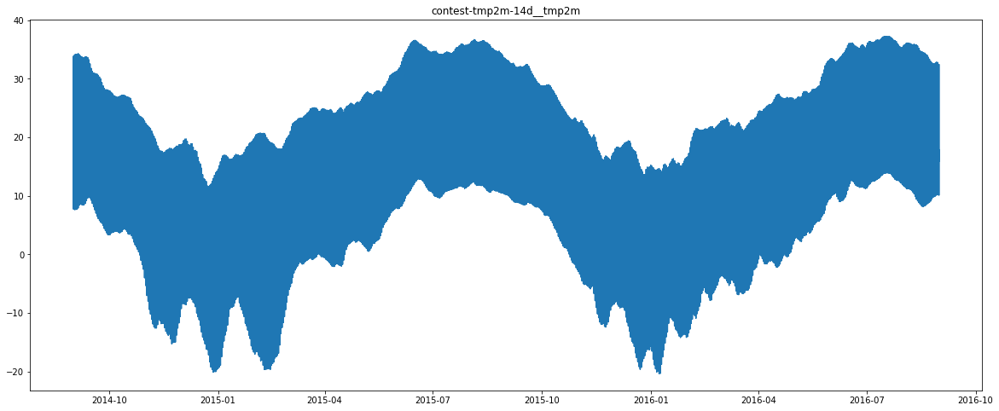

...

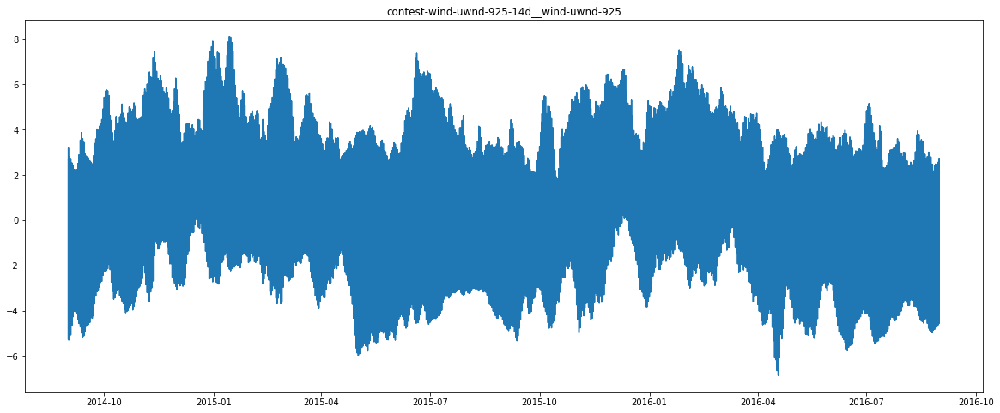

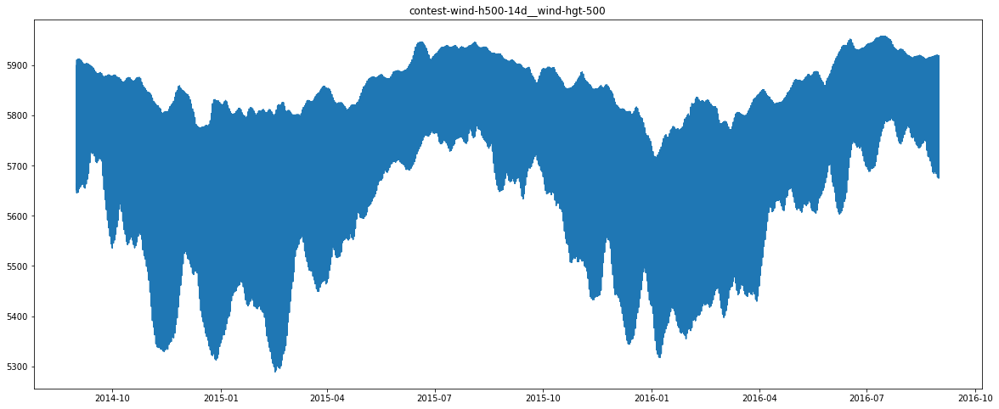

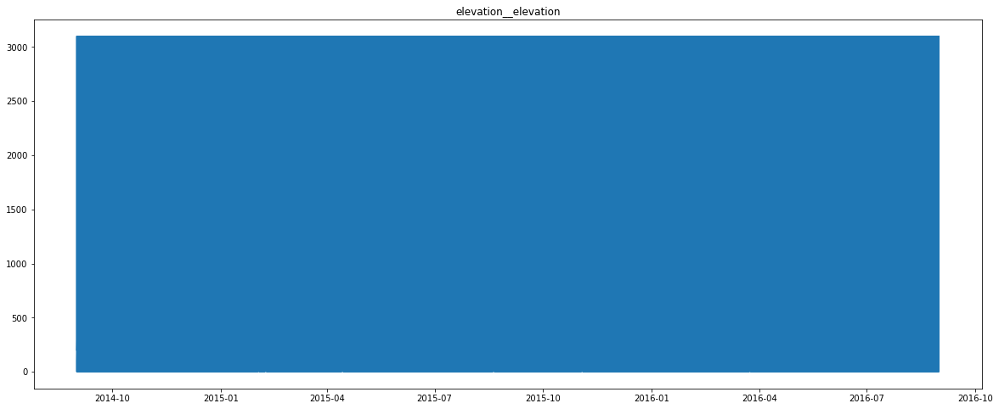

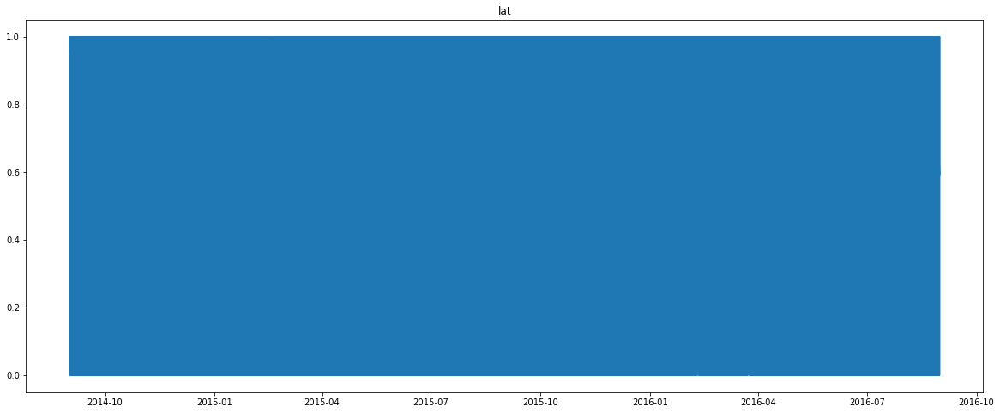

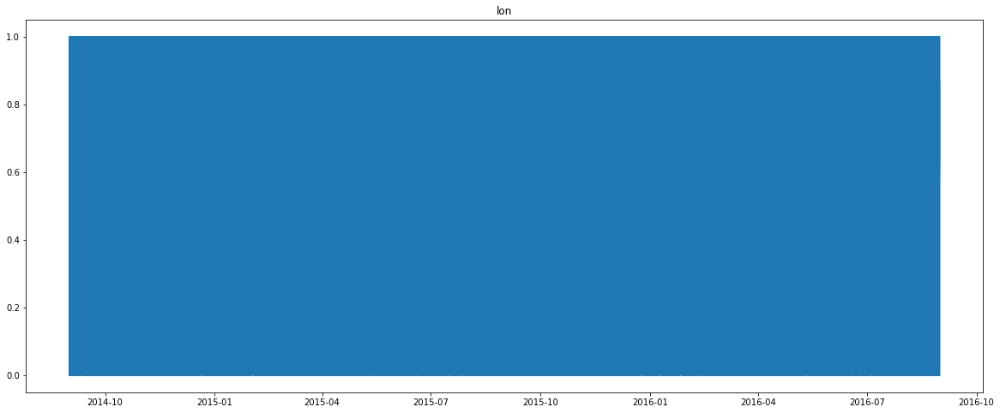

In [21]:
for col in contest_df.columns:
    fig, ax = plt.subplots(figsize=(20, 8))
    plt.plot(contest_df[col])
    plt.title(f'{col}')
    plt.show()

In [25]:
weather.groupby(['lat', 'lon']).count()

startdate  contest-pevpr-sfc-gauss-14d__pevpr  \
lat      lon                                                       
0.000000 0.833333        731                                 731   
         0.866667        731                                 731   
0.045455 0.833333        731                                 731   
         0.866667        731                                 731   
         0.900000        731                                 731   
0.090909 0.800000        731                                 731   
         0.833333        731                                 731   
         0.866667        731                                 731   
         0.900000        731                                 731   
         0.933333        731                                 731   
0.136364 0.666667        731                                 731   
         0.700000        731                                 731   
         0.733333        731                                 731   
         0.766667        731                                 731   
         0.800000        731                                 731   
         0.833333        731                                 731   
         0.866667        731                                 731   
         0.900000        731                                 731   
         0.933333        731                                 731   
         0.966667        731                                 731   
         1.000000        731                                 731   
0.181818 0.633333        731                                 731   
         0.666667        731                                 731   
         0.700000        731                                 731   
         0.733333        731                                 731   
         0.766667        731                                 731   
         0.800000        731                                 731   
         0.833333        731                                 731   
         0.866667        731                                 731   
         0.900000        731                                 731   
         0.933333        731                                 731   
         0.966667        731                                 731   
         1.000000        731                                 731   
0.227273 0.366667        731                                 731   
         0.400000        731                                 731   
         0.433333        731                                 731   
         0.466667        731                                 731   
         0.500000        731                                 731   
         0.533333        731                                 731   
         0.566667        731                                 731   
         0.600000        731                                 731   
         0.633333        731                                 731   
         0.666667        731                                 731   
         0.700000        731                                 731   
         0.733333        731                                 731   
         0.766667        731                                 731   
         0.800000        731                                 731   
         0.833333        731                                 731   
         0.866667        731                                 731   
         0.900000        731                                 731   
         0.933333        731                                 731   
         0.966667        731                                 731   
0.272727 0.233333        731                                 731   
         0.266667        731                                 731   
         0.300000        731                                 731   
         0.333333        731                                 731   
         0.366667        731                                 731   
       

In [26]:
from importlib import reload

In [35]:
features = ['climateregions__climateregion', 'elevation__elevation', 'lat', 'lon', 'startdate',
                 'contest-pevpr-sfc-gauss-14d__pevpr','contest-precip-14d__precip','contest-pres-sfc-gauss-14d__pres',
                 'contest-prwtr-eatm-14d__prwtr','contest-rhum-sig995-14d__rhum','contest-slp-14d__slp',
                 'contest-tmp2m-14d__tmp2m','contest-wind-h10-14d__wind-hgt-10','contest-wind-h100-14d__wind-hgt-100',
                 'contest-wind-h500-14d__wind-hgt-500','contest-wind-h850-14d__wind-hgt-850','contest-wind-uwnd-250-14d__wind-uwnd-250',
                 'contest-wind-uwnd-925-14d__wind-uwnd-925','contest-wind-vwnd-250-14d__wind-vwnd-250',
                 'contest-wind-vwnd-925-14d__wind-vwnd-925']

def get_explore_data():
    df = pd.read_csv('train_data.csv')
    return df

def prep_data(df, features=[]):
    if len(features) == 0:
        return df
    else:
        return df[features]

def split_data(df, test_size=0.15):
    '''
    Takes in a data frame and the train size
    It returns train, validate , and test data frames
    with validate being 0.05 bigger than test and train has the rest of the data.
    '''
    train, test = train_test_split(df, test_size = test_size , random_state=27)
    train, validate = train_test_split(train, test_size = (test_size + 0.05)/(1-test_size), random_state=27)
    
    return train, validate, test

In [36]:
df = get_explore_data()
df = prep_data(df)
train, validate, test = split_data(df)

In [37]:
test = list(train.columns)
test.remove('contest-tmp2m-14d__tmp2m')
test.remove('climateregions__climateregion')
test.remove('startdate')

In [31]:
from scipy import stats

In [20]:
def make_metric(metric_df, col, p):
    if metric_df.size ==0:
        metric_df = pd.DataFrame(data=[
            {
                'Column_name': col, 
                'p-value': p
            }])
        return metric_df
    else:
        return metric_df.append(
            {
                'Column_name': col, 
                'p-value': p
            }, ignore_index=True)

In [38]:
metric_df = pd.DataFrame()
for col in test:
    corr, p = stats.spearmanr(train[col], train['contest-tmp2m-14d__tmp2m'])
    metric_df = make_metric(metric_df, col, p)

metric_df

/var/folders/hj/mq308hhs3rz5q1mbkdf0261m0000gn/T/ipykernel_5260/2455659813.py:10: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  return metric_df.append(
/var/folders/hj/mq308hhs3rz5q1mbkdf0261m0000gn/T/ipykernel_5260/2455659813.py:10: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  return metric_df.append(
/var/folders/hj/mq308hhs3rz5q1mbkdf0261m0000gn/T/ipykernel_5260/2455659813.py:10: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  return metric_df.append(
/var/folders/hj/mq308hhs3rz5q1mbkdf0261m0000gn/T/ipykernel_5260/2455659813.py:10: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  return metric_df.append(
/var/folders/hj/mq308hhs3rz5q1mb

/var/folders/hj/mq308hhs3rz5q1mbkdf0261m0000gn/T/ipykernel_5260/2455659813.py:10: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  return metric_df.append(
/var/folders/hj/mq308hhs3rz5q1mbkdf0261m0000gn/T/ipykernel_5260/2455659813.py:10: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  return metric_df.append(
/var/folders/hj/mq308hhs3rz5q1mbkdf0261m0000gn/T/ipykernel_5260/2455659813.py:10: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  return metric_df.append(
/var/folders/hj/mq308hhs3rz5q1mbkdf0261m0000gn/T/ipykernel_5260/2455659813.py:10: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  return metric_df.append(
/var/folders/hj/mq308hhs3rz5q1mb

/var/folders/hj/mq308hhs3rz5q1mbkdf0261m0000gn/T/ipykernel_5260/2455659813.py:10: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  return metric_df.append(
/var/folders/hj/mq308hhs3rz5q1mbkdf0261m0000gn/T/ipykernel_5260/2455659813.py:10: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  return metric_df.append(
/var/folders/hj/mq308hhs3rz5q1mbkdf0261m0000gn/T/ipykernel_5260/2455659813.py:10: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  return metric_df.append(
/var/folders/hj/mq308hhs3rz5q1mbkdf0261m0000gn/T/ipykernel_5260/2455659813.py:10: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  return metric_df.append(
/var/folders/hj/mq308hhs3rz5q1mb

/var/folders/hj/mq308hhs3rz5q1mbkdf0261m0000gn/T/ipykernel_5260/2455659813.py:10: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  return metric_df.append(
/var/folders/hj/mq308hhs3rz5q1mbkdf0261m0000gn/T/ipykernel_5260/2455659813.py:10: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  return metric_df.append(
/var/folders/hj/mq308hhs3rz5q1mbkdf0261m0000gn/T/ipykernel_5260/2455659813.py:10: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  return metric_df.append(
/var/folders/hj/mq308hhs3rz5q1mbkdf0261m0000gn/T/ipykernel_5260/2455659813.py:10: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  return metric_df.append(
/var/folders/hj/mq308hhs3rz5q1mb

/var/folders/hj/mq308hhs3rz5q1mbkdf0261m0000gn/T/ipykernel_5260/2455659813.py:10: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  return metric_df.append(
/var/folders/hj/mq308hhs3rz5q1mbkdf0261m0000gn/T/ipykernel_5260/2455659813.py:10: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  return metric_df.append(
/var/folders/hj/mq308hhs3rz5q1mbkdf0261m0000gn/T/ipykernel_5260/2455659813.py:10: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  return metric_df.append(
/var/folders/hj/mq308hhs3rz5q1mbkdf0261m0000gn/T/ipykernel_5260/2455659813.py:10: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  return metric_df.append(
/var/folders/hj/mq308hhs3rz5q1mb

/var/folders/hj/mq308hhs3rz5q1mbkdf0261m0000gn/T/ipykernel_5260/2455659813.py:10: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  return metric_df.append(
/var/folders/hj/mq308hhs3rz5q1mbkdf0261m0000gn/T/ipykernel_5260/2455659813.py:10: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  return metric_df.append(
/var/folders/hj/mq308hhs3rz5q1mbkdf0261m0000gn/T/ipykernel_5260/2455659813.py:10: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  return metric_df.append(
/var/folders/hj/mq308hhs3rz5q1mbkdf0261m0000gn/T/ipykernel_5260/2455659813.py:10: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  return metric_df.append(
/var/folders/hj/mq308hhs3rz5q1mb

/var/folders/hj/mq308hhs3rz5q1mbkdf0261m0000gn/T/ipykernel_5260/2455659813.py:10: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  return metric_df.append(
/var/folders/hj/mq308hhs3rz5q1mbkdf0261m0000gn/T/ipykernel_5260/2455659813.py:10: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  return metric_df.append(
/var/folders/hj/mq308hhs3rz5q1mbkdf0261m0000gn/T/ipykernel_5260/2455659813.py:10: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  return metric_df.append(
/var/folders/hj/mq308hhs3rz5q1mbkdf0261m0000gn/T/ipykernel_5260/2455659813.py:10: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  return metric_df.append(
/var/folders/hj/mq308hhs3rz5q1mb

,Column_name,p-value
0,index,0.000000e+00
1,lat,0.000000e+00
2,lon,0.000000e+00
3,contest-pevpr-sfc-gauss-14d__pevpr,0.000000e+00
4,nmme0-tmp2m-34w__cancm30,0.000000e+00
5,nmme0-tmp2m-34w__cancm40,0.000000e+00
6,nmme0-tmp2m-34w__ccsm30,NaN
7,nmme0-tmp2m-34w__ccsm40,0.000000e+00
8,nmme0-tmp2m-34w__cfsv20,0.000000e+00
9,nmme0-tmp2m-34w__gfdlflora0,0.000000e+00
